In [1]:
# for loading/processing the images  
from tensorflow.keras.preprocessing.image import load_img 
from tensorflow.keras.preprocessing.image import img_to_array 
from tensorflow.keras.applications.vgg16 import preprocess_input 

# models 
from tensorflow.keras.applications.vgg16 import VGG16 
from tensorflow.keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

In [2]:
path = r"/home/zhu690/Downloads/5dogs/"
# change the working directory to the path where the images are located
os.chdir(path)


# this list holds all the image filename
flowers = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the flowers list
            flowers.append(file.name)

In [100]:
#5dogs set label encode
print(len(flowers))
labs={}
for i in flowers:
    typ=i.split('_')[0]
    if typ=='n02115913':
        labs[i]=0
    if typ=='n02113978':
        labs[i]=1
    if typ=='n02115641':
        labs[i]=2
    if typ=='n02115913':
        labs[i]=3
    if typ=='n02113799':
        labs[i]=4
len(labs)

789


620

In [3]:
#show img
img = load_img(flowers[0], target_size=(224,224))
# convert from 'PIL.Image.Image' to numpy array
img = np.array(img)
print(img.shape)
reshaped_img = img.reshape(1,224,224,3)
print(reshaped_img.shape)
x = preprocess_input(reshaped_img)

(224, 224, 3)
(1, 224, 224, 3)


In [4]:
# load the model first and pass as an argument
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

In [5]:
data = {}
p = path
# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat.shape

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)
feat.shape

(789, 4096)

In [6]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data_rescaled = scaler.fit_transform(feat)

In [8]:
#95% of variance
pca = PCA(n_components = 0.95)
pca.fit(data_rescaled)
reduced = pca.transform(data_rescaled)

In [9]:
reduced.shape

(789, 445)

In [5]:
#manually select number of features
# pca = PCA(n_components=100, random_state=22)
# pca.fit(feat)
# x = pca.transform(feat)

In [10]:
from scipy.spatial.distance import cdist
from sklearn.metrics import silhouette_score
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
silhouette=[]
K = range(2,10)
x=reduced
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(x)
    kmeanModel.fit(x)
    sse=sum(np.min(cdist(x, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / x.shape[0]
    distortions.append(sse)
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(x, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / x.shape[0]
    mapping2[k] = kmeanModel.inertia_
    
    silhouette.append(silhouette_score(x, kmeanModel.labels_))

In [11]:
bestk=K[(silhouette.index(max(silhouette)))]

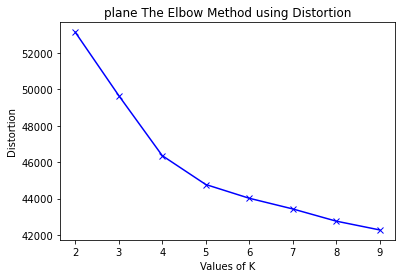

In [12]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('plane The Elbow Method using Distortion')
plt.show()

In [13]:
kmeans = KMeans(n_clusters=bestk,n_jobs=-1, random_state=22)
kmeans.fit(x)

/home/zhu690/anaconda3/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:973: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=5, n_jobs=-1, random_state=22)

In [13]:
kmeans.labels_

array([0, 1, 0, 1, 0, 0, 0, 0, 1, 2, 2, 2, 1, 0, 0, 0, 2, 1, 0, 0, 0, 0,
       2, 1, 0, 2, 0, 2, 2, 0, 2, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 2, 1, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 0, 1, 0, 0, 2, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 2, 1, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 2, 1, 1, 1, 0, 2, 2, 0, 0, 1, 0, 1, 2,
       1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 2, 0, 0,
       0, 2, 0, 2, 0, 0, 0, 1, 0, 2, 0, 0, 1, 0, 0, 0, 1, 1, 2, 2, 0, 2,
       0, 1, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 1, 2, 2, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 0, 2, 0, 0, 2, 0, 1, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0,
       0, 0, 2, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 2, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 2,
       1, 2, 1, 0, 1, 0, 1, 0, 2, 0, 0, 0, 2, 0, 1, 0, 0, 0, 2, 0, 0, 0,
       1, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 1, 0, 0, 2, 2,
       1, 0, 1, 0, 0, 1, 1, 2, 0, 0, 0, 0, 0, 2, 0,

In [23]:
#cluster dic key:index, val: filename
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

In [24]:
#check numbet of items in each cluster
for i in groups:
    print(len(groups[i]))

164
154
155
157
159


In [83]:
groups

{2: ['n02115913_2320.jpg',
  'n02115913_359.jpg',
  'n02115641_6707.jpg',
  'n02115913_3753.jpg',
  'n02115913_4266.jpg',
  'n02115913_1188.jpg',
  'n02115913_1682.jpg',
  'n02115913_2480.jpg',
  'n02115913_4055.jpg',
  'n02115641_6183.jpg',
  'n02115641_10604.jpg',
  'n02115641_2424.jpg',
  'n02115913_612.jpg',
  'n02115913_1578.jpg',
  'n02115913_3527.jpg',
  'n02116738_6790.jpg',
  'n02115641_6747.jpg',
  'n02115913_539.jpg',
  'n02115913_4144.jpg',
  'n02115913_25.jpg',
  'n02115913_1742.jpg',
  'n02115913_2657.jpg',
  'n02115913_2005.jpg',
  'n02115913_3878.jpg',
  'n02115913_593.jpg',
  'n02115913_3529.jpg',
  'n02115913_3010.jpg',
  'n02115641_1969.jpg',
  'n02115913_1332.jpg',
  'n02115913_1677.jpg',
  'n02115913_4129.jpg',
  'n02115913_250.jpg',
  'n02115913_2524.jpg',
  'n02115913_90.jpg',
  'n02115913_4313.jpg',
  'n02115913_257.jpg',
  'n02115913_4031.jpg',
  'n02115913_1637.jpg',
  'n02115913_262.jpg',
  'n02115913_2338.jpg',
  'n02115913_219.jpg',
  'n02115913_678.jpg',
 

In [25]:
#checking with true label
# for i in groups:
#     imgs=groups[i]
#     label_=[]
#     for im in imgs:
#         if im in labs.keys():
#             label_.append(labs[im])
#     print(label_)  

NameError: name 'labs' is not defined

In [16]:
def view_cluster(cluster):
    plt.figure(figsize = (45,45));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:50]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

Clipping cluster size from 315 to 30


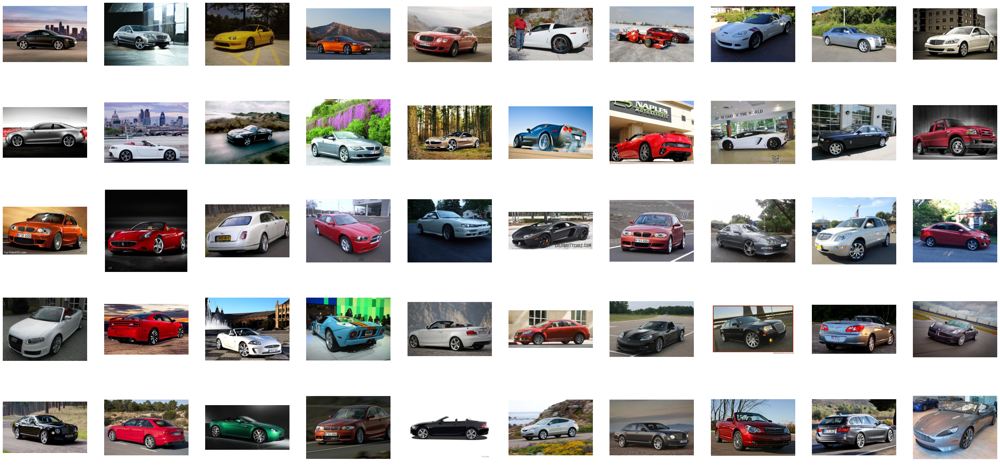

In [53]:
#stanford_cars (the variables is not saved. just for demo, so no need to run agian)
view_cluster(0)

Clipping cluster size from 368 to 30


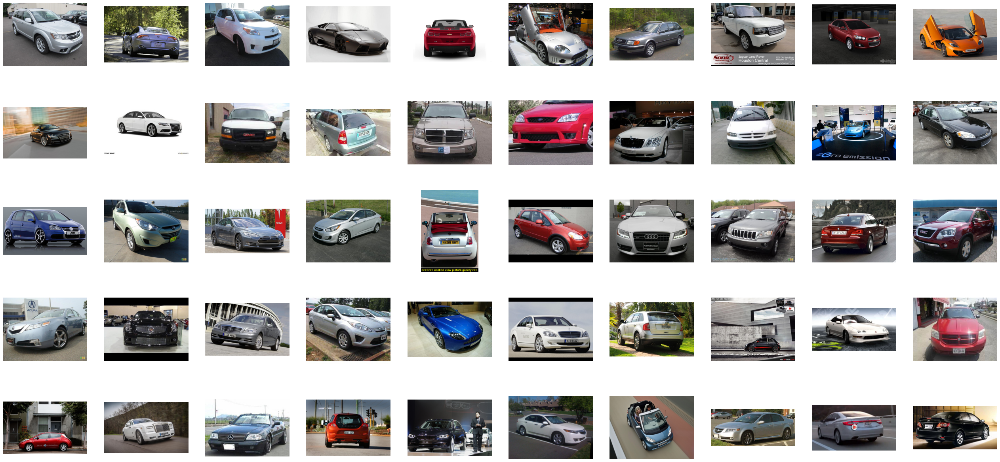

In [54]:
view_cluster(1)

Clipping cluster size from 317 to 30


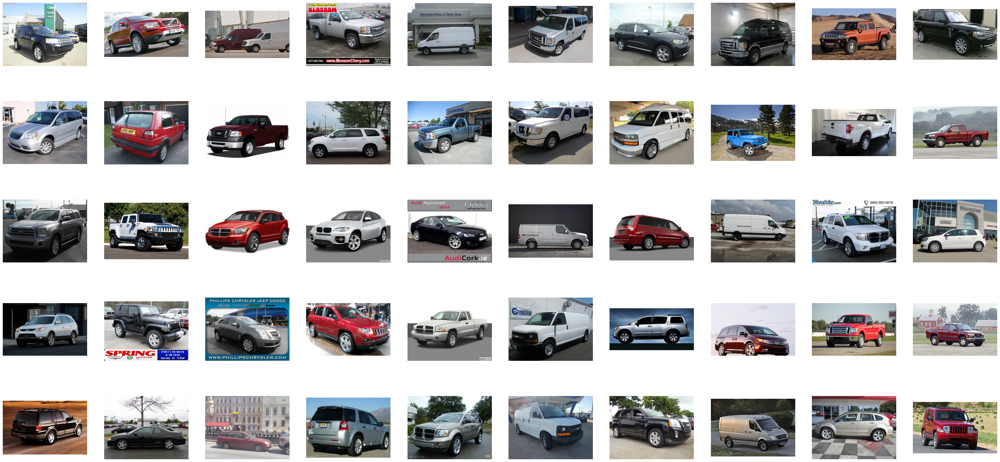

In [55]:
view_cluster(2)

Clipping cluster size from 51 to 30


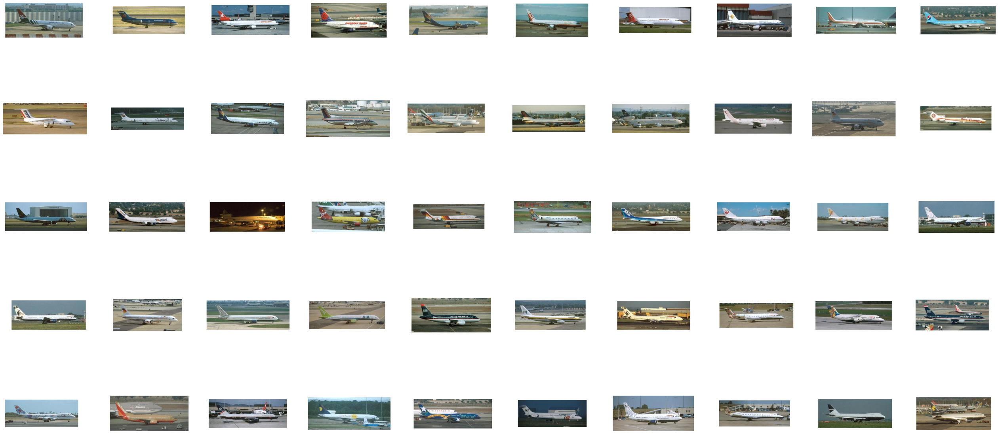

In [74]:
#Plane
view_cluster(0)

Clipping cluster size from 45 to 30


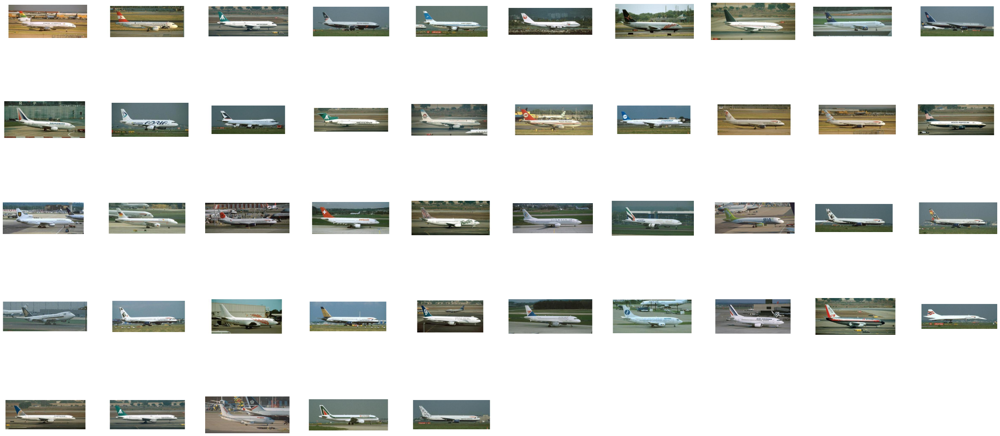

In [75]:
view_cluster(1)

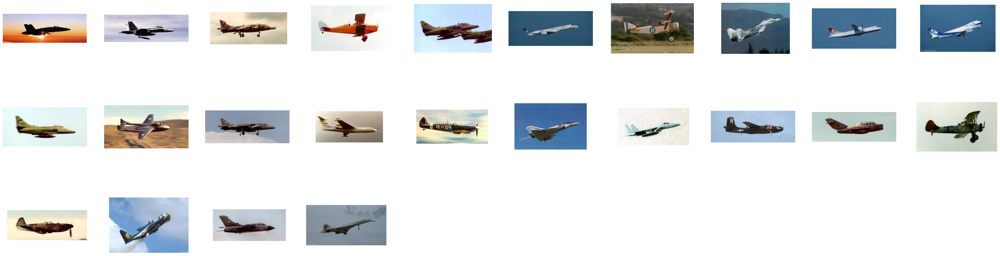

In [76]:
view_cluster(2)

Clipping cluster size from 157 to 30


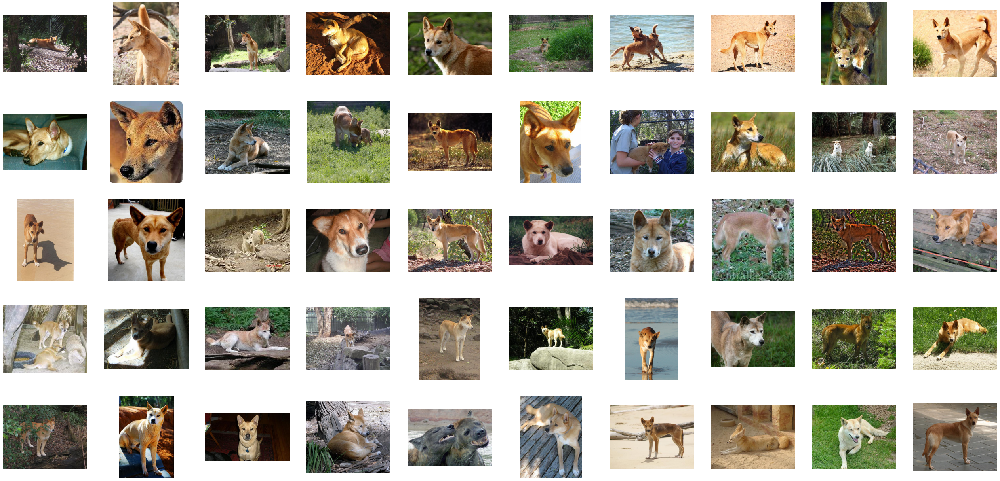

In [26]:
#dogs
view_cluster(0)

Clipping cluster size from 153 to 30


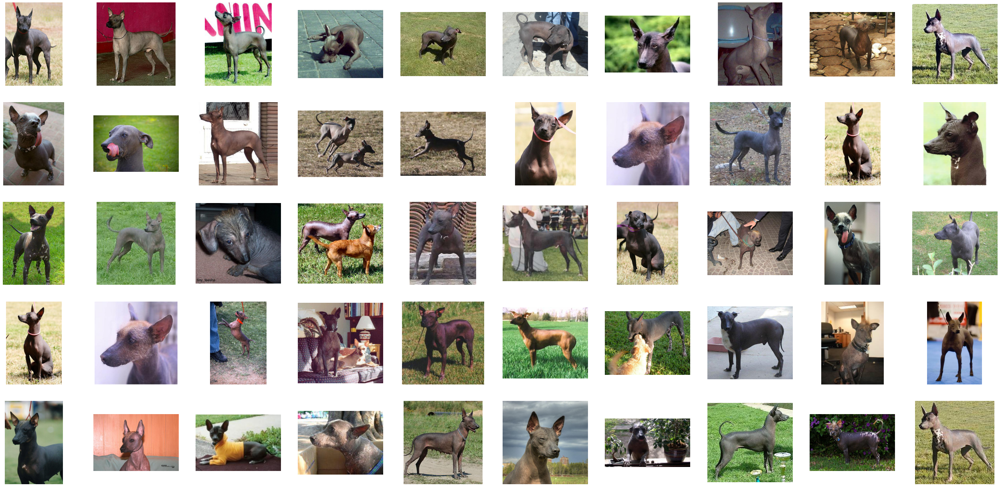

In [18]:
view_cluster(1)

Clipping cluster size from 157 to 30


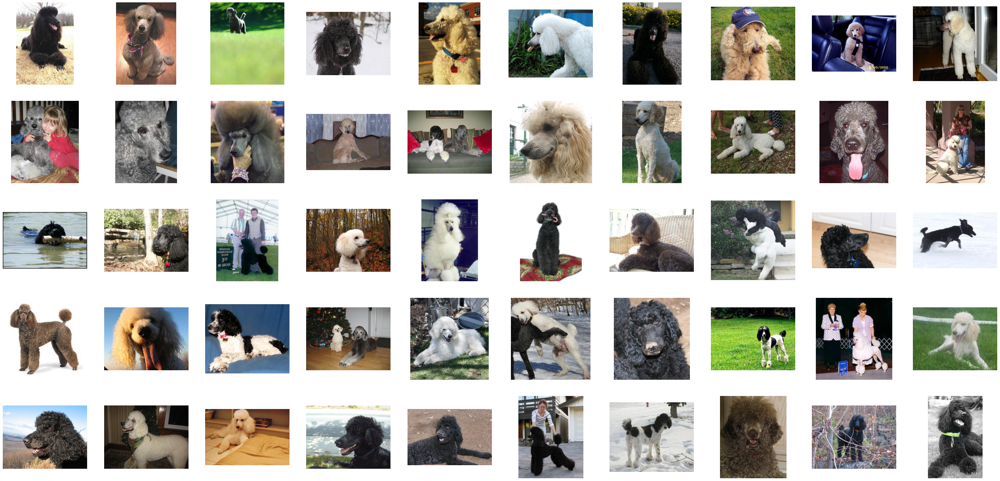

In [19]:
view_cluster(2)